## Install Detectron2 and Mediapipe

In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

In [ ]:
!pip install torch torchvision opencv-python timm mediapipe

## Import Necessary Libraries

In [ ]:
import torch, detectron2
!nvcc --version

In [ ]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

In [ ]:
import torch
import cv2
from PIL import Image
import matplotlib.pyplot as plt
from torchvision.transforms import Compose, Resize, ToTensor, Normalize
model_type = "DPT_Large"     # Options: DPT_Large, DPT_Hybrid, or MiDaS_small
midas = torch.hub.load("intel-isl/MiDaS", model_type)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
midas.to(device)
midas.eval()

## Define Configuration File and Setup Detectron2

In [ ]:
DATA_SET_NAME = 'Toy-Segment'
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"

In [ ]:
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = '</path to train folder'
TRAIN_DATA_SET_ANN_FILE_PATH = '<path to train annotation'

register_coco_instances(
    name=TRAIN_DATA_SET_NAME,
    metadata={},
    json_file=TRAIN_DATA_SET_ANN_FILE_PATH,
    image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
)

# TEST SET
TEST_DATA_SET_NAME = f"{DATA_SET_NAME}-test"
TEST_DATA_SET_IMAGES_DIR_PATH = '</path to validation folder'
TEST_DATA_SET_ANN_FILE_PATH = '</path to validation annotation'

register_coco_instances(
    name=TEST_DATA_SET_NAME,
    metadata={},
    json_file=TEST_DATA_SET_ANN_FILE_PATH,
    image_root=TEST_DATA_SET_IMAGES_DIR_PATH
)

# VALID SET
VALID_DATA_SET_NAME = f"{DATA_SET_NAME}-valid"
VALID_DATA_SET_IMAGES_DIR_PATH = '</path to test folder'
VALID_DATA_SET_ANN_FILE_PATH = '</path to test annotation '

register_coco_instances(
    name=VALID_DATA_SET_NAME,
    metadata={},
    json_file=VALID_DATA_SET_ANN_FILE_PATH,
    image_root=VALID_DATA_SET_IMAGES_DIR_PATH
)

We can now confirm that our custom dataset was correctly registered using [MetadataCatalog](https://detectron2.readthedocs.io/en/latest/modules/data.html#detectron2.data.MetadataCatalog).

In [ ]:
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

['Toy-Segment-train', 'Toy-Segment-test', 'Toy-Segment-valid']

In [ ]:
# HYPERPARAMETERS
ARCHITECTURE = "mask_rcnn_R_101_FPN_3x"
CONFIG_FILE_PATH = f"COCO-InstanceSegmentation/{ARCHITECTURE}.yaml"
MAX_ITER = 8000
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 3


In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH)
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.INPUT.MASK_FORMAT='bitmask'
cfg.SOLVER.BASE_LR = BASE_LR
cfg.SOLVER.MAX_ITER = MAX_ITER
cfg.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
# cfg.OUTPUT_DIR = OUTPUT_DIR_PATH

In [ ]:
cfg.MODEL.WEIGHTS = '<path to trained toy model .pth path>'
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.1
predictor = DefaultPredictor(cfg)

#visualising predicted Toys

/content/drive/MyDrive/masters_thesis/lab20/20231211_132619.jpg


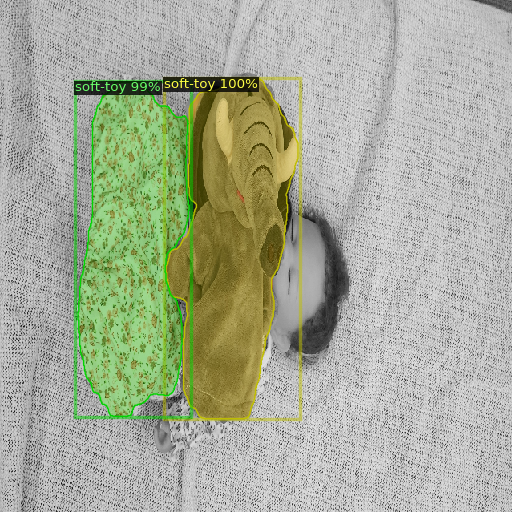

/content/drive/MyDrive/masters_thesis/lab20/20231211_132335.jpg


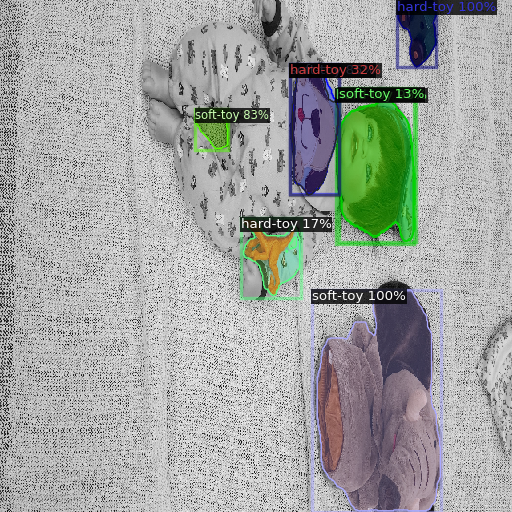

/content/drive/MyDrive/masters_thesis/lab20/20231211_132643.jpg


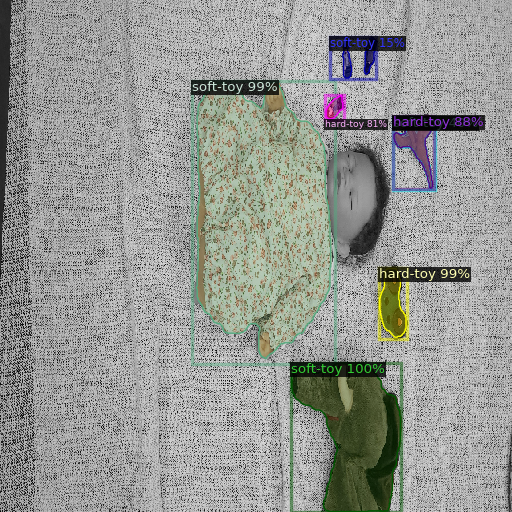

/content/drive/MyDrive/masters_thesis/lab20/20231211_132721.jpg


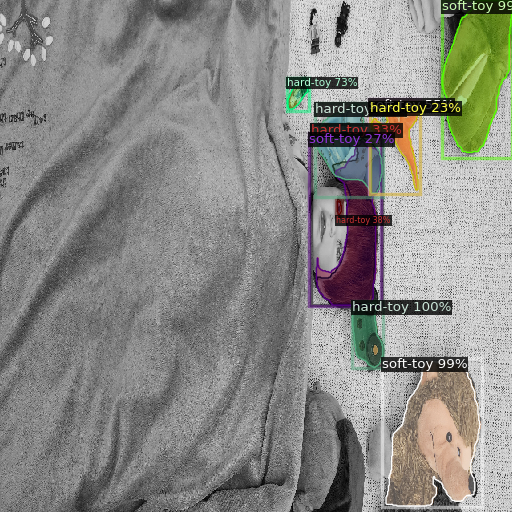

/content/drive/MyDrive/masters_thesis/lab20/20231211_132318.jpg


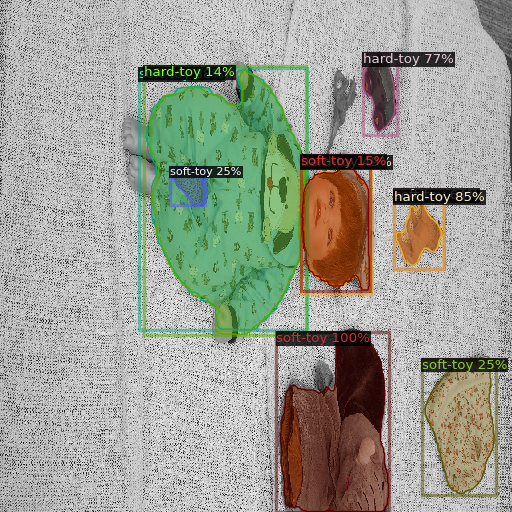

/content/drive/MyDrive/masters_thesis/lab20/20231211_132602.jpg


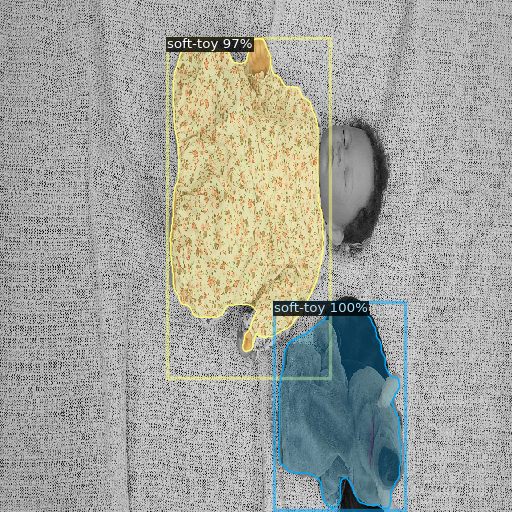

/content/drive/MyDrive/masters_thesis/lab20/20231211_132311.jpg


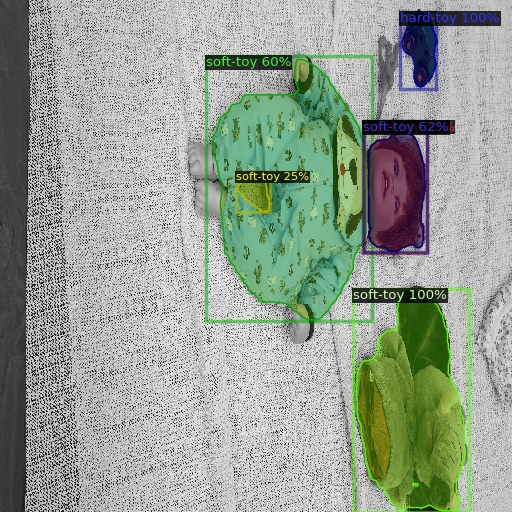

/content/drive/MyDrive/masters_thesis/lab20/20231211_132241.jpg


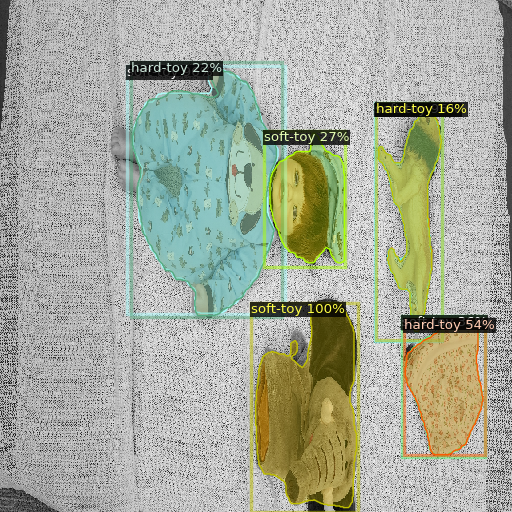

/content/drive/MyDrive/masters_thesis/lab20/20231211_132710.jpg


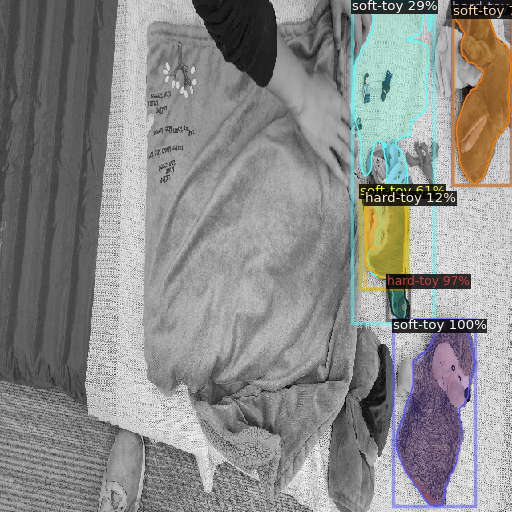

/content/drive/MyDrive/masters_thesis/lab20/20231211_132235.jpg


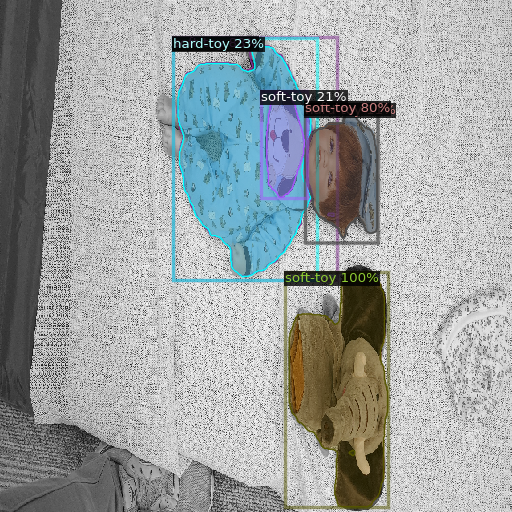

/content/drive/MyDrive/masters_thesis/lab20/20231211_132459.jpg


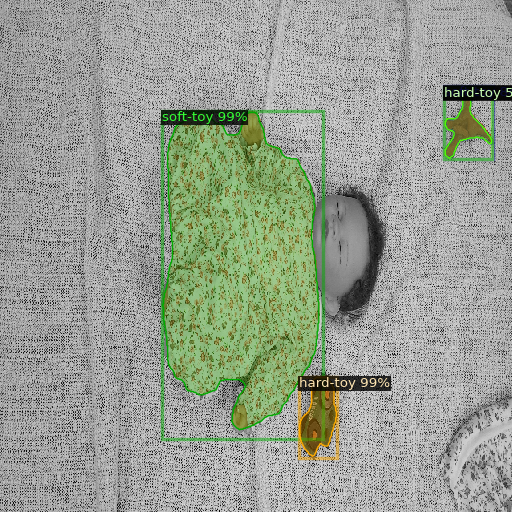

/content/drive/MyDrive/masters_thesis/lab20/20231211_132713.jpg


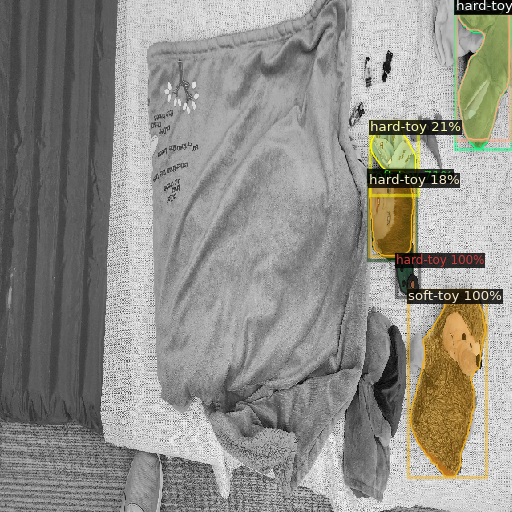

/content/drive/MyDrive/masters_thesis/lab20/20231211_120327.jpg


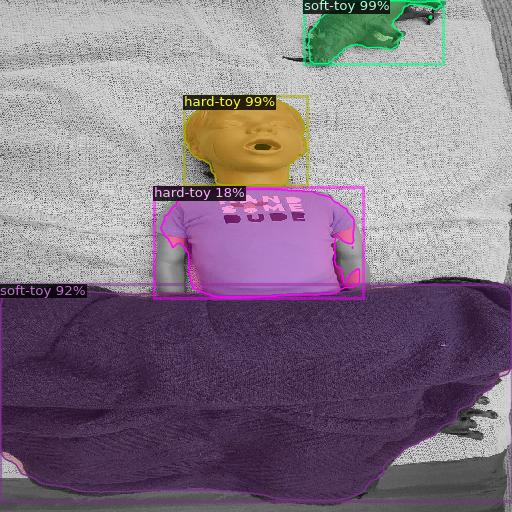

/content/drive/MyDrive/masters_thesis/lab20/20231211_131057.jpg


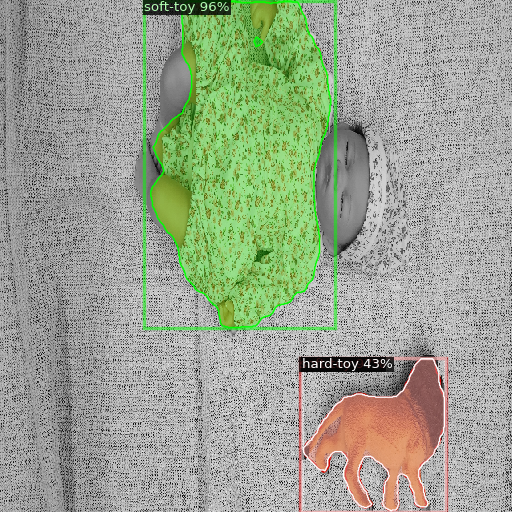

/content/drive/MyDrive/masters_thesis/lab20/20231211_132700.jpg


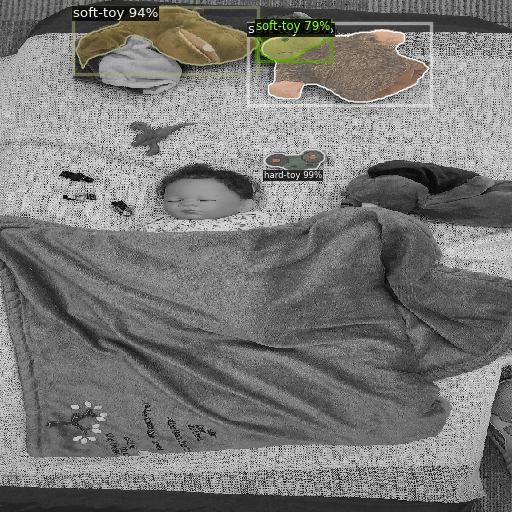

/content/drive/MyDrive/masters_thesis/lab20/20231211_132718.jpg


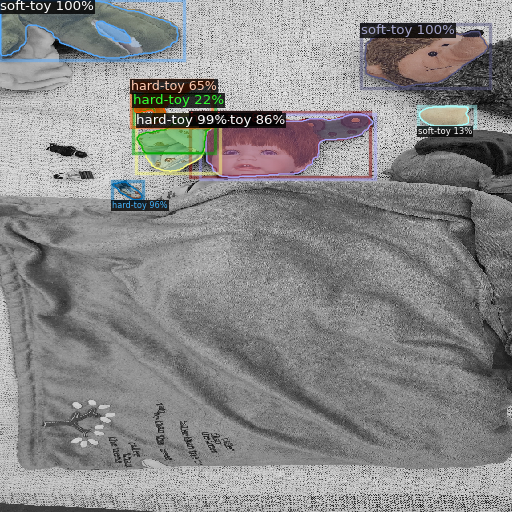

In [ ]:
import os
dataset = os.listdir('path to test toy images')
for d in dataset:
    path = 'path to test toy images' + d
    print(path)
    img = cv2.imread(path)
    img = cv2.resize(img, (640,640))
    outputs = predictor(img)

    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=metadata,
        scale=0.8,
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

# PIpeline to Detect Hazardeous Toys

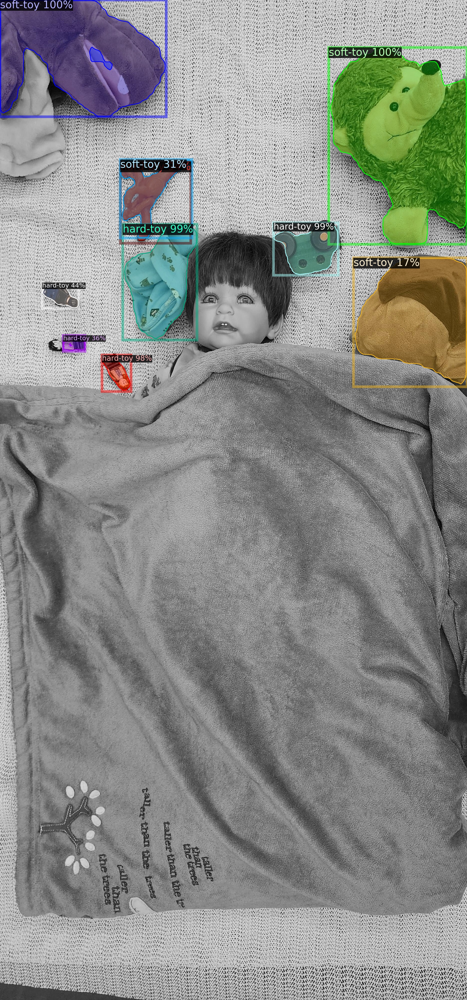

In [ ]:
img = cv2.imread("path to image to be tested")
# img = cv2.resize(img, (640,640))
outputs = predictor(img)

visualizer = Visualizer(
    img[:, :, ::-1],
    metadata=metadata,
    # scale=0.8,
    instance_mode=ColorMode.IMAGE_BW
)
out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
visualized_image = out.get_image()[:, :, ::-1]
cv2_imshow(visualized_image)

# Filter toys based on the threshold size



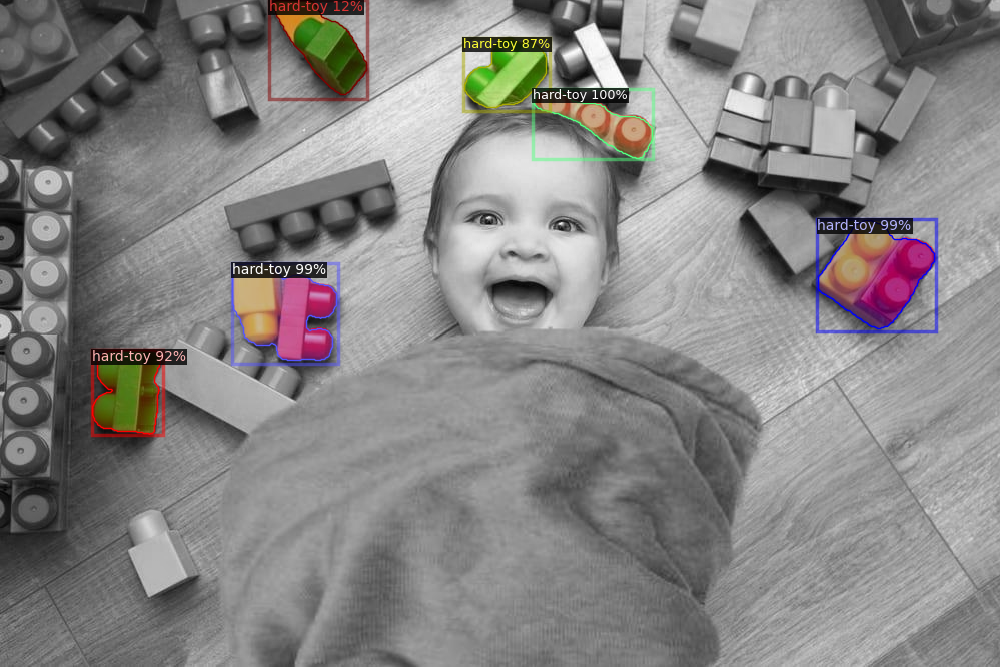

In [ ]:
import cv2
import numpy as np
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.structures import Instances

# Load and resize the image
img = cv2.imread("/content/test12.jpg")
# img = cv2.resize(img, (640, 640))

# Run the prediction
outputs = predictor(img)

# Filter instances by the area of the segmented region
threshold_area = 8000  # Set your threshold area here
instances = outputs["instances"].to("cpu")

# Calculate the area of each mask and create a mask for selected instances
mask_areas = instances.pred_masks.sum(dim=[1, 2])  # Sum of each mask
selected_idx = mask_areas < threshold_area  # Select masks with area less than the threshold

# Create an empty Instances object for selected instances
selected_instances = Instances(instances.image_size)

for field in instances.get_fields():
    field_data = getattr(instances, field)
    if field == "pred_masks":
        # Apply the filter to masks
        selected_instances.set(field, field_data[selected_idx])
    else:
        # For other fields, select corresponding data using the same index
        if len(field_data) > 0:  # Check if the field is not empty
            selected_instances.set(field, field_data[selected_idx])

# Visualize the results
visualizer = Visualizer(img[:, :, ::-1], metadata=metadata,  instance_mode=ColorMode.IMAGE_BW)
out = visualizer.draw_instance_predictions(selected_instances)

# Display the image
cv2_imshow(out.get_image()[:, :, ::-1])


# Define Utility Functions

In [ ]:
# Utility Functions
def normalized_to_pixel_coordinates(normalized_x, normalized_y, image_width, image_height):
    """Converts normalized coordinates to pixel coordinates."""
    x_px = min(math.floor(normalized_x * image_width), image_width - 1)
    y_px = min(math.floor(normalized_y * image_height), image_height - 1)
    return x_px, y_px

def calculate_polygon_area(vertices):
    """Calculates the area of a polygon given its vertices using the Shoelace formula."""
    n = len(vertices)
    area = 0.0
    for i in range(n):
        j = (i + 1) % n
        area += vertices[i][0] * vertices[j][1]
        area -= vertices[j][0] * vertices[i][1]
    area = abs(area) / 2.0
    return area

def draw_dotted_line(img, point1, point2, color, thickness=1, style='dotted', gap=20):
    """Draws a dotted line between two points."""
    dist = ((point1[0] - point2[0]) ** 2 + (point1[1] - point2[1]) ** 2) ** 0.5
    points = []
    for i in np.arange(0, dist, gap):
        r = i / dist
        x = int((point1[0] * (1 - r) + point2[0] * r) + 0.5)
        y = int((point1[1] * (1 - r) + point2[1] * r) + 0.5)
        points.append((x, y))
    if style == 'dotted':
        for p in points:
            cv2.circle(img, p, thickness, color, -1)
    else:
        e = points[0]
        i = 0
        for p in points:
            s = e
            e = p
            if i % 2 == 1:
                cv2.line(img, s, e, color, thickness)
            i += 1

# Filter the Hazardeous Toys based on the Distance of reach

## Calculate the mouth area

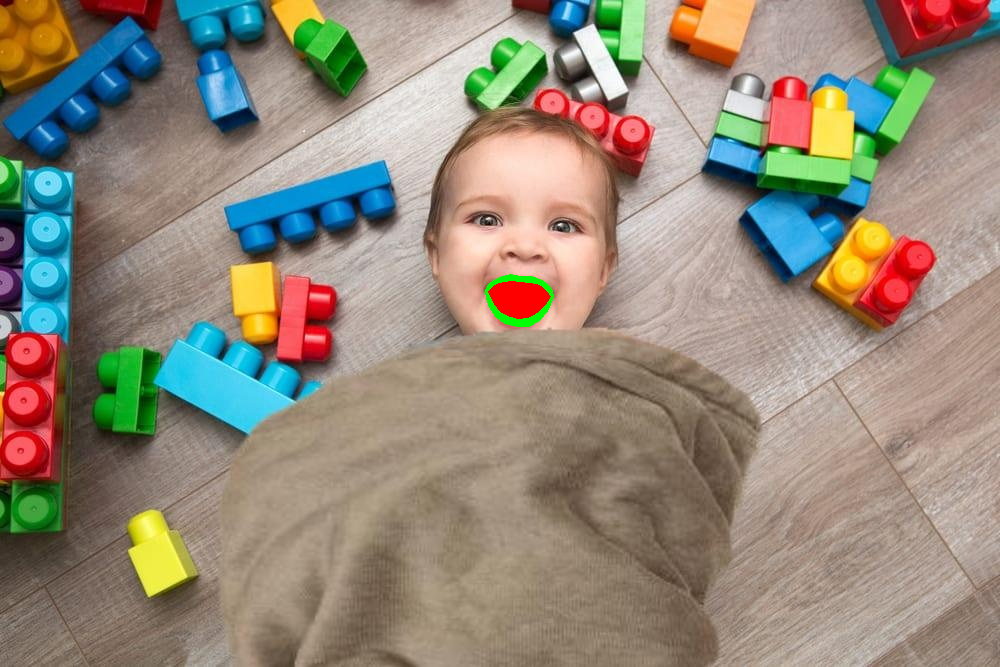

In [ ]:
import cv2
import numpy as np
import mediapipe as mp
import math
from google.colab.patches import cv2_imshow


mp_face_mesh = mp.solutions.face_mesh
face_mesh = mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=1, refine_landmarks=True)


lips_outer = [61, 185, 40, 39, 37, 0, 267, 269, 270, 409, 291, 375, 321, 405, 314, 17, 84, 181, 91, 146, 61]
lips_inner = [78, 191, 80, 81, 82, 13, 312, 311, 310, 415, 308, 324, 318, 402, 317, 14, 87, 178, 88, 95, 78]

imagefm = cv2.imread('/content/test12.jpg')

# Convert the image to a standard NumPy array and ensure it's in BGR format
image = np.array(imagefm)
if image.shape[2] == 4:  # Check if the image has an alpha channel
    image = cv2.cvtColor(image, cv2.COLOR_BGRA2BGR)

results = face_mesh.process(image)

if results.multi_face_landmarks:
    for face_landmarks in results.multi_face_landmarks:

        lip_coordinates_outer = []
        lip_coordinates_inner = []
        for idx in lips_outer:
            lm = face_landmarks.landmark[idx]
            x_px, y_px = normalized_to_pixel_coordinates(lm.x, lm.y, image.shape[1], image.shape[0])
            lip_coordinates_outer.append((x_px, y_px))

        for idx in lips_inner:
            lm = face_landmarks.landmark[idx]
            x_px, y_px = normalized_to_pixel_coordinates(lm.x, lm.y, image.shape[1], image.shape[0])
            lip_coordinates_inner.append((x_px, y_px))


        if lip_coordinates_outer:
            cv2.fillPoly(image, [np.array(lip_coordinates_outer, dtype=np.int32)], (0, 255, 0))
        if lip_coordinates_inner:
            cv2.fillPoly(image, [np.array(lip_coordinates_inner, dtype=np.int32)], (0, 0, 255))


        mouth_area_outer = calculate_polygon_area(lip_coordinates_outer)
        mouth_area_inner = calculate_polygon_area(lip_coordinates_inner)
        # print(f"Approximate Outer Mouth Area: {mouth_area_outer} pixels²")
        # print(f"Approximate Inner Mouth Area: {mouth_area_inner} pixels²")

cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()
face_mesh.close()

## Find the distance of every Toy from the mouth

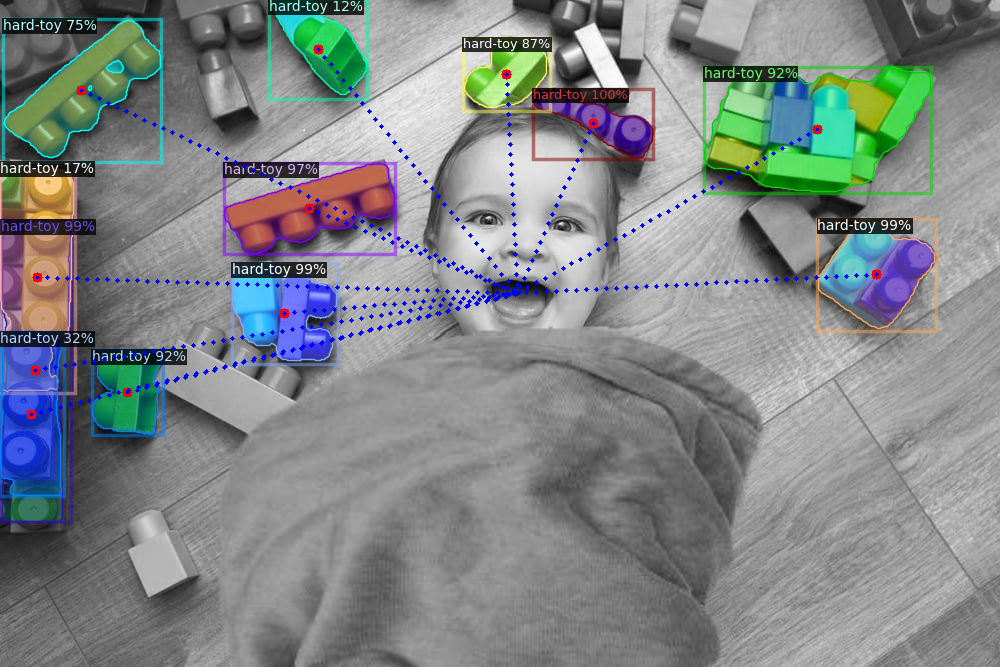

In [ ]:
mouth_centroid = None
if lip_coordinates_outer:
    mouth_centroid = np.mean(lip_coordinates_outer, axis=0)

# Calculate the center of each bounding box and draw dotted lines
for i in range(len(selected_instances)):
    bbox = selected_instances.pred_boxes[i].tensor.numpy()[0]
    bbox_center_x = int((bbox[2] + bbox[0]) / 2)
    bbox_center_y = int((bbox[3] + bbox[1]) / 2)
    cv2.circle(image, (bbox_center_x, bbox_center_y), radius=5, color=(0, 0, 255), thickness=-1)


    # Check if mouth_centroid was calculated and draw dotted line
    if mouth_centroid is not None:
        draw_dotted_line(image, (bbox_center_x, bbox_center_y),
                         (int(mouth_centroid[0]), int(mouth_centroid[1])),
                         color=(255, 0, 0), thickness=2, gap=10)


# Show the result
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

## Filter the toys Based on Distance thresold

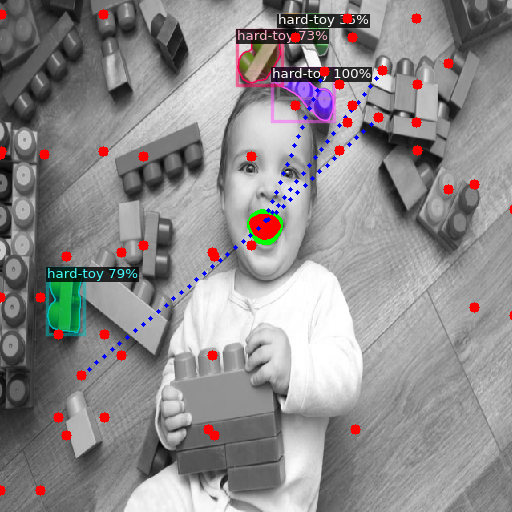

In [ ]:

# Draw corner dots
for i in range(len(outputs["instances"])):
    bbox = outputs["instances"][i].to("cpu").pred_boxes.tensor.numpy()[0]
    corners = [
        (int(bbox[0]), int(bbox[1])),  # Top-left
        (int(bbox[2]), int(bbox[1])),  # Top-right
        (int(bbox[2]), int(bbox[3])),  # Bottom-right
        (int(bbox[0]), int(bbox[3]))   # Bottom-left
    ]

    for corner in corners:
        cv2.circle(image, corner, radius=5, color=(0, 0, 255), thickness=-1)

cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()


# Pipeline to Filter Toys Based on Correaltion Between Area of Mouth & Distance of Reach

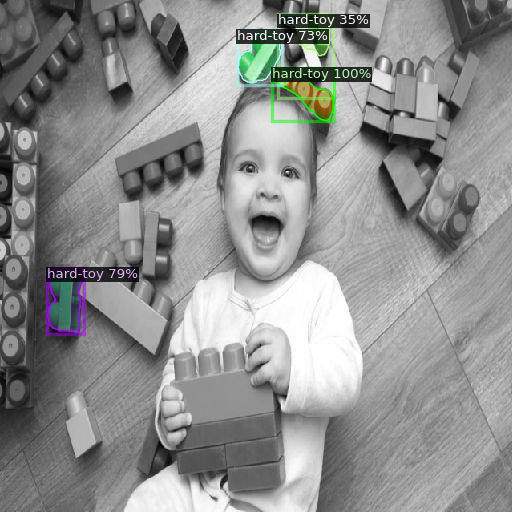

0.0
0.0
0.0
0.0


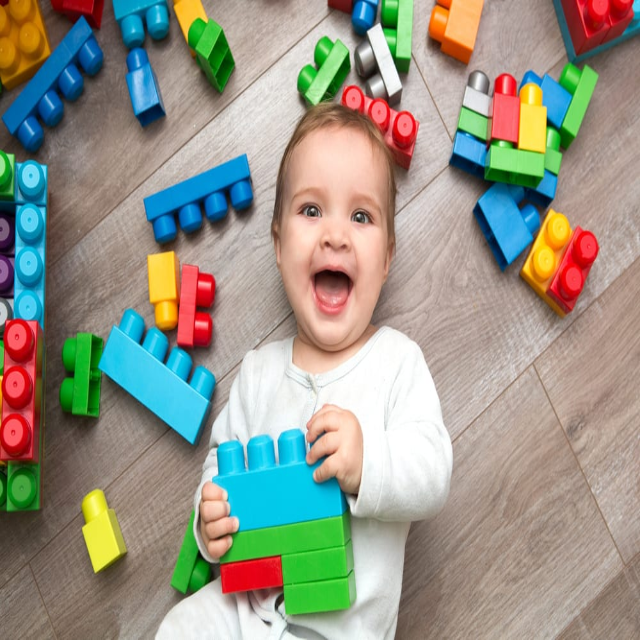

In [ ]:
import cv2
import numpy as np
import mediapipe as mp
import math
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.structures import Instances
from google.colab.patches import cv2_imshow



# MediaPipe Face Mesh Setup
mp_face_mesh = mp.solutions.face_mesh
face_mesh = mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=1, refine_landmarks=True)
lips_outer = [61, 185, 40, 39, 37, 0, 267, 269, 270, 409, 291, 375, 321, 405, 314, 17, 84, 181, 91, 146, 61]

# Load Image and Run MediaPipe
image = cv2.imread('/content/test12.jpg')
image = cv2.resize(image, (640, 640))
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
results = face_mesh.process(image_rgb)

# Extract Mouth Coordinates from MediaPipe Results
lip_coordinates_outer = []
if results.multi_face_landmarks:
    for face_landmarks in results.multi_face_landmarks:
        for idx in lips_outer:
            lm = face_landmarks.landmark[idx]
            x_px, y_px = normalized_to_pixel_coordinates(lm.x, lm.y, image.shape[1], image.shape[0])
            lip_coordinates_outer.append((x_px, y_px))

outputs = predictor(image)
instances = outputs["instances"].to("cpu")
mask_areas = instances.pred_masks.sum(dim=[1, 2])  # Sum of each mask
selected_idx = mask_areas < 3000  # Select masks with area less than 3000

selected_instances = Instances(instances.image_size)
for field in instances.get_fields():
    field_data = getattr(instances, field)
    if field == "pred_masks":
        selected_instances.set(field, field_data[selected_idx])
    else:
        if len(field_data) > 0:
            selected_instances.set(field, field_data[selected_idx])

visualizer = Visualizer(image[:, :, ::-1], metadata=metadata, scale=0.8, instance_mode=ColorMode.IMAGE_BW)
out = visualizer.draw_instance_predictions(selected_instances)
cv2_imshow(out.get_image()[:, :, ::-1])

# Draw Dotted Lines Based on Proximity
mouth_centroid = calculate_polygon_area(np.array(lip_coordinates_outer, dtype=np.int32))
for i in range(len(selected_instances)):
    mask = selected_instances.pred_masks[i].numpy().astype(np.uint8)
    centroid = calculate_polygon_area(mask)
    print(centroid)
    if centroid:
        distance = math.sqrt((centroid[0] - mouth_centroid[0]) ** 2 + (centroid[1] - mouth_centroid[1]) ** 2)
        if distance <= 100:  # Proximity threshold
            draw_dotted_line(image, centroid, mouth_centroid, (255, 0, 0))

# Show the Result
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()
face_mesh.close()
